# **Time Series Prediction using FBProphet**

# **Importing Libraries**

In [ ]:
from prophet import Prophet
from prophet.plot import plot_plotly
import plotly.offline as py
from plotly.offline import plot, iplot
import plotly.graph_objects as go
import plotly.io as pio
# Initialize Plotly for Jupyte Notebook
py.init_notebook_mode(connected=True)
import warnings
warnings.filterwarnings("ignore")


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from io import StringIO
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# **Yearly Data**

Adding column names based on their dataset descriptions


Convert year.5 to Proper Date:


For a year like 1700.5, it corresponds to July 1 of that year.
We will create a new column with the date formatted as YYYY-MM-DD using datetime.

In [ ]:
columns = [
    "Year",
    "Yearly_Mean_Sunspot_Number",
    "Yearly_Mean_Standard_Deviation",
    "Number_of_Observations",
    "Definitive_Indicator"
]

# Read the CSV file with a semicolon delimiter
df_year = pd.read_csv('SN_y_tot_V2.0.csv',delimiter=';',header=None, names=columns)

# Create the time column based on 'Year'
df_year['Year'] = df_year['Year'].astype(float)

# Extract integer year and month
df_year['Year_Int'] = df_year['Year'].astype(int)  # Extract integer part for year
df_year['Month'] = df_year['Year'] % 1  # Get the decimal part for month

# Convert the decimal part to month. If it's .5, it corresponds to July.
df_year['Month'] = df_year['Month'].apply(lambda x: 7 if x >= 0.5 else 1)

# Create a new column 'time' with datetime format using year and month
df_year['date'] = pd.to_datetime(df_year['Year_Int'].astype(str) + '-' + df_year['Month'].astype(str) + '-01')

In [ ]:
df_year.head()

,Year,Yearly_Mean_Sunspot_Number,Yearly_Mean_Standard_Deviation,Number_of_Observations,Definitive_Indicator,Year_Int,Month,date
0,1700.5,8.3,-1.0,-1,1,1700,7,1700-07-01
1,1701.5,18.3,-1.0,-1,1,1701,7,1701-07-01
2,1702.5,26.7,-1.0,-1,1,1702,7,1702-07-01
3,1703.5,38.3,-1.0,-1,1,1703,7,1703-07-01
4,1704.5,60.0,-1.0,-1,1,1704,7,1704-07-01


In [ ]:
df_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 322 entries, 0 to 321
Data columns (total 8 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Year                            322 non-null    float64       
 1   Yearly_Mean_Sunspot_Number      322 non-null    float64       
 2   Yearly_Mean_Standard_Deviation  322 non-null    float64       
 3   Number_of_Observations          322 non-null    int64         
 4   Definitive_Indicator            322 non-null    int64         
 5   Year_Int                        322 non-null    int64         
 6   Month                           322 non-null    int64         
 7   date                            322 non-null    datetime64[ns]
dtypes: datetime64[ns](1), float64(3), int64(4)
memory usage: 20.2 KB


In [ ]:
df_year.shape

(322, 8)

# **Checking Null Values**

In [ ]:
df_year.isnull().sum()

,0
Year,0
Yearly_Mean_Sunspot_Number,0
Yearly_Mean_Standard_Deviation,0
Number_of_Observations,0
Definitive_Indicator,0
Year_Int,0
Month,0
date,0


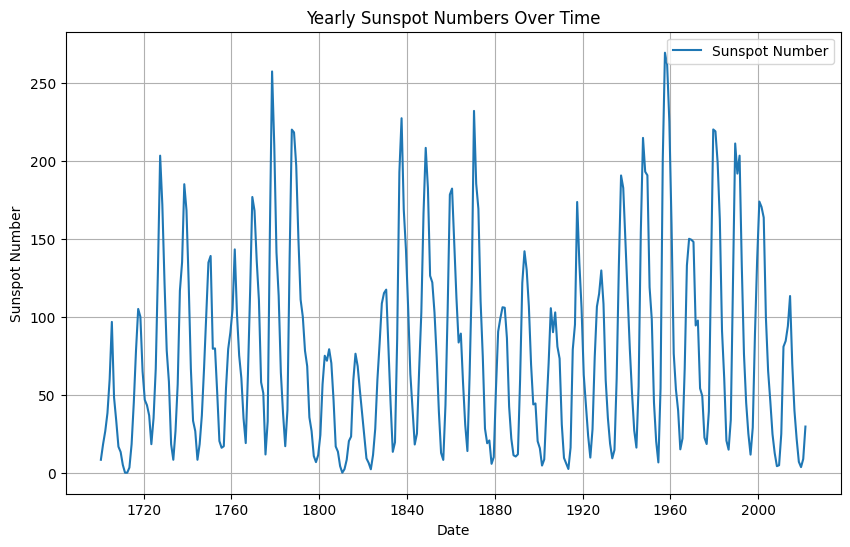

In [ ]:

# Plotting the sunspot data
plt.figure(figsize=(10, 6))

# Plot the sunspot numbers (ignoring -1 for visualization)
plt.plot(df_year['date'], df_year['Yearly_Mean_Sunspot_Number'], label='Sunspot Number', color='tab:blue')
# Title and labels
plt.title('Yearly Sunspot Numbers Over Time')
plt.xlabel('Date')
plt.ylabel('Sunspot Number')

# Show legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

In [ ]:
df_yearly = df_year.rename(columns={'date': 'ds', 'Yearly_Mean_Sunspot_Number': 'y'})
df_yearly.head()

,Year,y,Yearly_Mean_Standard_Deviation,Number_of_Observations,Definitive_Indicator,Year_Int,Month,ds
0,1700.5,8.3,-1.0,-1,1,1700,7,1700-07-01
1,1701.5,18.3,-1.0,-1,1,1701,7,1701-07-01
2,1702.5,26.7,-1.0,-1,1,1702,7,1702-07-01
3,1703.5,38.3,-1.0,-1,1,1703,7,1703-07-01
4,1704.5,60.0,-1.0,-1,1,1704,7,1704-07-01


In [ ]:
print(df_yearly['ds'].min(), df_yearly['ds'].max())


1700-07-01 00:00:00 2021-07-01 00:00:00


The "overflow condition" typically arises when the date range or values in your data exceed the bounds that your system or library can handle.

To resolve this we have taken dates between 1792-01-01 - 2022-01-01

In [ ]:
df_yearly = df_yearly[df_yearly['ds'].between('1750-01-01', '2022-01-01')]

In [ ]:
# Train the model
model_yearly = Prophet()
model_yearly.fit(df_yearly)  # Assuming df_yearly has columns 'ds' and 'y'

# Make future dataframe for predictions
future_yearly = model_yearly.make_future_dataframe(periods=20, freq='YE')  # 20 years into the future
print(future_yearly.tail())
forecast_yearly = model_yearly.predict(future_yearly)

# Extract specific periods for predictions
yearly_predictions = forecast_yearly[forecast_yearly['ds'].isin([
    future_yearly['ds'].iloc[-1],   # 1 year
    future_yearly['ds'].iloc[-10], # 10 years
    future_yearly['ds'].iloc[-20]  # 20 years
])]
print(yearly_predictions[['ds', 'yhat']])


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/h8ptqrqp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/wegq260z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73929', 'data', 'file=/tmp/tmp57weo3qh/h8ptqrqp.json', 'init=/tmp/tmp57weo3qh/wegq260z.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_modellbedepsj/prophet_model-20241129184118.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:41:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


            ds
287 2036-12-31
288 2037-12-31
289 2038-12-31
290 2039-12-31
291 2040-12-31
            ds        yhat
272 2021-12-31  144.026948
282 2031-12-31  144.459162
291 2040-12-31  144.887593


In [ ]:
# Check the date range
print(df_yearly['ds'].min(), df_yearly['ds'].max())

# Ensure 'ds' is in proper datetime format
df_yearly['ds'] = pd.to_datetime(df_yearly['ds'], errors='coerce')
df_yearly.dropna(subset=['ds'], inplace=True)

# Check for invalid dates
print(df_yearly.head())


1750-07-01 00:00:00 2021-07-01 00:00:00
      Year      y  Yearly_Mean_Standard_Deviation  Number_of_Observations  \
50  1750.5  139.0                            -1.0                      -1   
51  1751.5   79.5                            -1.0                      -1   
52  1752.5   79.7                            -1.0                      -1   
53  1753.5   51.2                            -1.0                      -1   
54  1754.5   20.3                            -1.0                      -1   

    Definitive_Indicator  Year_Int  Month         ds  
50                     1      1750      7 1750-07-01  
51                     1      1751      7 1751-07-01  
52                     1      1752      7 1752-07-01  
53                     1      1753      7 1753-07-01  
54                     1      1754      7 1754-07-01  


In [ ]:
# Try a different frequency for testing
future_yearly = model_yearly.make_future_dataframe(periods=20, freq='YS')  # Start of the year
forecast_yearly = model_yearly.predict(future_yearly)

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score

def evaluate_model(test, forecast):
    y_true = test['y'].values
    y_pred = forecast['yhat'].values

    mae = mean_absolute_error(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred) * 100  # Mean Absolute Percentage Error

    # Check if there are enough samples to calculate R²
    if len(y_true) > 1:  # R² needs at least 2 samples
        r2 = r2_score(y_true, y_pred)
    else:
        r2 = float('nan')  # If not enough data, set R² as NaN

    return mae, mape, r2


In [ ]:

# Train-test split for yearly data
train_yearly = df_yearly[df_yearly['ds'] < '2021-01-01']  # Up to 2020
test_yearly = df_yearly[df_yearly['ds'] >= '2021-01-01']  # From 2021 onwards

In [ ]:

from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score

# Define the function for fitting and predicting
def fit_and_predict_model(train, test, growth_type='linear', yearly_seasonality=True, weekly_seasonality=False, **params):
    model = Prophet(growth=growth_type,
                    yearly_seasonality=yearly_seasonality,
                    weekly_seasonality=weekly_seasonality,
                    **params)
    model.fit(train)

    # Prepare the future dataframe for prediction (test set)
    future = test[['ds']]

    # Predict future values
    forecast = model.predict(future)

    # Calculate performance metrics
    mae = mean_absolute_error(test['y'], forecast['yhat'])
    mape = mean_absolute_percentage_error(test['y'], forecast['yhat'])
    r2 = r2_score(test['y'], forecast['yhat'])

    return model, forecast, mae, mape, r2



In [ ]:
# --- Linear Growth Model for Yearly Data ---
linear_yearly_model, linear_yearly_forecast, mae_linear_yearly, mape_linear_yearly, r2_linear_yearly = fit_and_predict_model(
    train_yearly, test_yearly, growth_type='linear', yearly_seasonality=True, weekly_seasonality=False
)

# --- Flat Growth Model for Yearly Data ---
flat_yearly_model, flat_yearly_forecast, mae_flat_yearly, mape_flat_yearly, r2_flat_yearly = fit_and_predict_model(
    train_yearly, test_yearly, growth_type='flat', yearly_seasonality=True, weekly_seasonality=False
)

# --- Logistic Growth Model for Yearly Data ---
# Prepare data (make sure 'ds' and 'y' columns exist in the dataframe)
df_yearly['cap'] = 100  # Set a capacity for logistic growth (adjust this value as needed)

# Adding cap to both training and test datasets for logistic growth
train_yearly['cap'] = 100
test_yearly['cap'] = 100

# Logistic Growth Model for Yearly Data
logistic_yearly_model = Prophet(growth='logistic',
                                yearly_seasonality=True,
                                weekly_seasonality=False,
                                n_changepoints=20,  # Experiment with the number of changepoints
                                changepoint_prior_scale=0.01)
logistic_yearly_model.fit(train_yearly)

# Prepare the future dataframe for prediction (test set)
future_yearly = test_yearly[['ds']]  # We need the 'ds' column for future dates
future_yearly['cap'] = 100  # Add the 'cap' column to future dataframe

# Predict future values for logistic growth
logistic_yearly_forecast = logistic_yearly_model.predict(future_yearly)

# --- Evaluate Logistic Growth Model ---
mae_logistic_yearly, mape_logistic_yearly, r2_logistic_yearly = evaluate_model(test_yearly, logistic_yearly_forecast)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/wl6lp6lu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/xxcyd6qd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57596', 'data', 'file=/tmp/tmp57weo3qh/wl6lp6lu.json', 'init=/tmp/tmp57weo3qh/xxcyd6qd.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_model8p7rs5o7/prophet_model-20241129184119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:41:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57

In [ ]:

print("\nYearly Models Evaluation:")
print(f"Linear Model MAE: {mae_linear_yearly:.2f}, MAPE: {mape_linear_yearly:.2f}%, R2: {r2_linear_yearly:.2f}")
print(f"Flat Model MAE: {mae_flat_yearly:.2f}, MAPE: {mape_flat_yearly:.2f}%, R2: {r2_flat_yearly:.2f}")
print(f"Logistic Model MAE: {mae_logistic_yearly:.2f}, MAPE: {mape_logistic_yearly:.2f}%, R2: {r2_logistic_yearly:.2f}")



Yearly Models Evaluation:
Linear Model MAE: 55.19, MAPE: 1.86%, R2: nan
Flat Model MAE: 51.23, MAPE: 1.73%, R2: nan
Logistic Model MAE: 12.01, MAPE: 40.58%, R2: nan


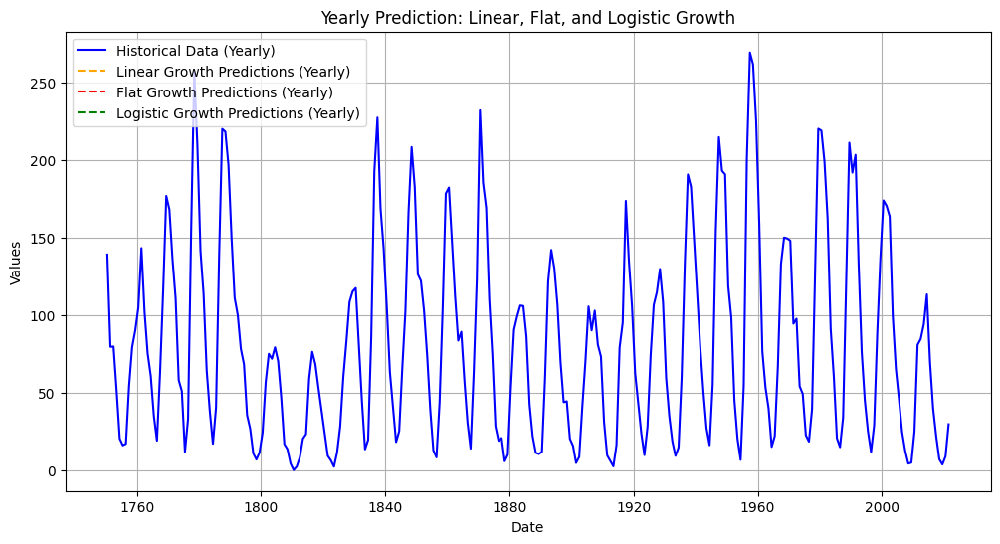

In [ ]:
# --- Plotting the results for Yearly Data ---
plt.figure(figsize=(12, 6))
plt.plot(df_yearly['ds'], df_yearly['y'], label='Historical Data (Yearly)', color='blue')
plt.plot(linear_yearly_forecast['ds'], linear_yearly_forecast['yhat'], label='Linear Growth Predictions (Yearly)', color='orange', linestyle='--')
plt.plot(flat_yearly_forecast['ds'], flat_yearly_forecast['yhat'], label='Flat Growth Predictions (Yearly)', color='red', linestyle='--')
plt.plot(logistic_yearly_forecast['ds'], logistic_yearly_forecast['yhat'], label='Logistic Growth Predictions (Yearly)', color='green', linestyle='--')
plt.title("Yearly Prediction: Linear, Flat, and Logistic Growth")
plt.xlabel("Date")
plt.ylabel("Values")
plt.legend(loc='best')
plt.grid(True)
plt.show()

In [ ]:

# --- Print predicted values for Yearly Data Models ---
print("\nYearly Linear Growth Model Predicted Values:")
print(linear_yearly_forecast[['ds', 'yhat']].head())

print("\nYearly Flat Growth Model Predicted Values:")
print(flat_yearly_forecast[['ds', 'yhat']].head())

print("\nYearly Logistic Growth Model Predicted Values:")
print(logistic_yearly_forecast[['ds', 'yhat']].head())



Yearly Linear Growth Model Predicted Values:
          ds       yhat
0 2021-07-01  84.792061

Yearly Flat Growth Model Predicted Values:
          ds       yhat
0 2021-07-01  80.825172

Yearly Logistic Growth Model Predicted Values:
          ds       yhat
0 2021-07-01  41.610539


# **Monthly Data**

Adding column names based on their dataset descriptions

In [ ]:
columns = [
    "Year", "Month", "Fraction_Year",
    "Monthly_Mean_Sunspot_Number", "Monthly_Mean_Standard_Deviation",
    "Number_of_Observations", "Definitive_Indicator"
]

# Read the CSV file with a semicolon delimiter
df_month = pd.read_csv('SN_m_tot_V2.0.csv',delimiter=';',header=None, names=columns)


In [ ]:

df_month.head()

,Year,Month,Fraction_Year,Monthly_Mean_Sunspot_Number,Monthly_Mean_Standard_Deviation,Number_of_Observations,Definitive_Indicator
0,1749,1,1749.042,96.7,-1.0,-1,1
1,1749,2,1749.123,104.3,-1.0,-1,1
2,1749,3,1749.204,116.7,-1.0,-1,1
3,1749,4,1749.288,92.8,-1.0,-1,1
4,1749,5,1749.371,141.7,-1.0,-1,1


Assuming the data is recorded on the first day of each month, the date format has been standardized to YYYY-MM-DD.

In [ ]:
# Handle monthly data (first day of the month)
if 'Month' in df_month.columns and 'Year' in df_month.columns:
    df_month['date'] = pd.to_datetime(df_month['Year'].astype(str) + '-' + df_month['Month'].astype(str) + '-01')
    print("Time column for monthly data created successfully.")

df_month.head()

Time column for monthly data created successfully.


,Year,Month,Fraction_Year,Monthly_Mean_Sunspot_Number,Monthly_Mean_Standard_Deviation,Number_of_Observations,Definitive_Indicator,date
0,1749,1,1749.042,96.7,-1.0,-1,1,1749-01-01
1,1749,2,1749.123,104.3,-1.0,-1,1,1749-02-01
2,1749,3,1749.204,116.7,-1.0,-1,1,1749-03-01
3,1749,4,1749.288,92.8,-1.0,-1,1,1749-04-01
4,1749,5,1749.371,141.7,-1.0,-1,1,1749-05-01


In [ ]:
df_month.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3280 entries, 0 to 3279
Data columns (total 8 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Year                             3280 non-null   int64         
 1   Month                            3280 non-null   int64         
 2   Fraction_Year                    3280 non-null   float64       
 3   Monthly_Mean_Sunspot_Number      3280 non-null   float64       
 4   Monthly_Mean_Standard_Deviation  3280 non-null   float64       
 5   Number_of_Observations           3280 non-null   int64         
 6   Definitive_Indicator             3280 non-null   int64         
 7   date                             3280 non-null   datetime64[ns]
dtypes: datetime64[ns](1), float64(3), int64(4)
memory usage: 205.1 KB


In [ ]:
df_month.shape

(3280, 8)

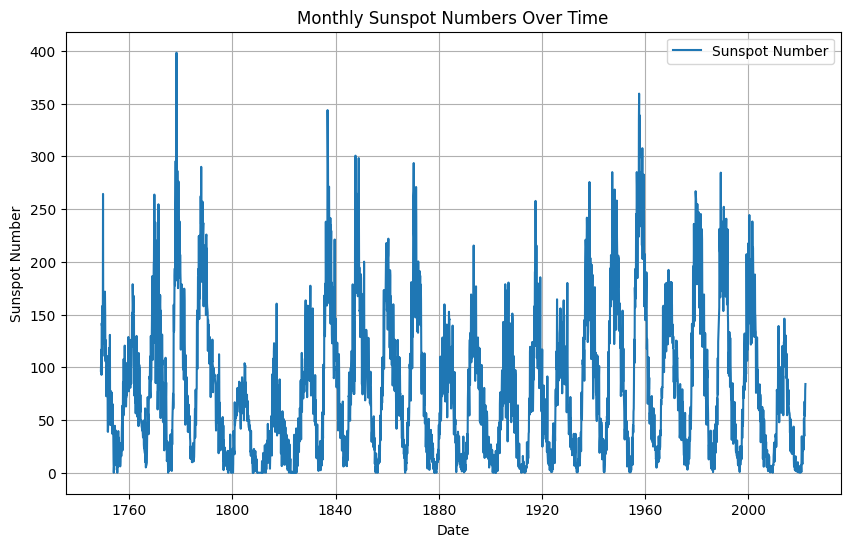

In [ ]:

# Plotting the sunspot data
plt.figure(figsize=(10, 6))

# Plot the sunspot numbers (ignoring -1 for visualization)
plt.plot(df_month['date'], df_month['Monthly_Mean_Sunspot_Number'], label='Sunspot Number', color='tab:blue')
# Title and labels
plt.title('Monthly Sunspot Numbers Over Time')
plt.xlabel('Date')
plt.ylabel('Sunspot Number')

# Show legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

In [ ]:
df_monthly = df_month.rename(columns={'date': 'ds', 'Monthly_Mean_Sunspot_Number': 'y'})
df_monthly.head()

,Year,Month,Fraction_Year,y,Monthly_Mean_Standard_Deviation,Number_of_Observations,Definitive_Indicator,ds
0,1749,1,1749.042,96.7,-1.0,-1,1,1749-01-01
1,1749,2,1749.123,104.3,-1.0,-1,1,1749-02-01
2,1749,3,1749.204,116.7,-1.0,-1,1,1749-03-01
3,1749,4,1749.288,92.8,-1.0,-1,1,1749-04-01
4,1749,5,1749.371,141.7,-1.0,-1,1,1749-05-01


In [ ]:
# Train the model
model_monthly = Prophet()
model_monthly.fit(df_monthly)  # Assuming df_monthly has columns 'ds' and 'y'

# Make future dataframe for predictions
future_monthly = model_monthly.make_future_dataframe(periods=9, freq='ME')  # 9 months into the future
forecast_monthly = model_monthly.predict(future_monthly)

# Extract specific periods for predictions
monthly_predictions = forecast_monthly[forecast_monthly['ds'].isin([
    future_monthly['ds'].iloc[-1],   # 1 month
    future_monthly['ds'].iloc[-6],  # 6 months
    future_monthly['ds'].iloc[-9]   # 9 months
])]
print(monthly_predictions[['ds', 'yhat']])


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/zdrevciw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/07pgzm__.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54433', 'data', 'file=/tmp/tmp57weo3qh/zdrevciw.json', 'init=/tmp/tmp57weo3qh/07pgzm__.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_model6rccrxxn/prophet_model-20241129184122.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:41:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


             ds       yhat
3280 2022-04-30  52.455930
3283 2022-07-31  61.757182
3288 2022-12-31  54.159313


In [ ]:
forecast_monthly.head()


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,1749-01-01,96.452004,2.796125,173.251313,96.452004,96.452004,-4.139376,-4.139376,-4.139376,-4.139376,-4.139376,-4.139376,0.0,0.0,0.0,92.312628
1,1749-02-01,96.409787,9.205296,178.436004,96.409787,96.409787,-2.566199,-2.566199,-2.566199,-2.566199,-2.566199,-2.566199,0.0,0.0,0.0,93.843588
2,1749-03-01,96.371655,1.357865,173.513120,96.371655,96.371655,-4.089821,-4.089821,-4.089821,-4.089821,-4.089821,-4.089821,0.0,0.0,0.0,92.281835
3,1749-04-01,96.329438,9.882713,180.871311,96.329438,96.329438,0.066268,0.066268,0.066268,0.066268,0.066268,0.066268,0.0,0.0,0.0,96.395706
4,1749-05-01,96.288583,13.563658,181.869514,96.288583,96.288583,5.341185,5.341185,5.341185,5.341185,5.341185,5.341185,0.0,0.0,0.0,101.629768


In [ ]:

pio.renderers.default = "colab"
# Generate the figure
fig_monthly = plot_plotly(model_monthly, forecast_monthly)

# Render the figure in Colab
iplot(fig_monthly)


Prediting # of Sunspots 1/6/12 month into the future

In [ ]:
import plotly.graph_objects as go

# Extract specific periods for predictions (e.g., 1 month, 6 months, 12 months)
monthly_predictions = forecast_monthly[forecast_monthly['ds'].isin([
    future_monthly['ds'].iloc[-1],   # 1 month
    future_monthly['ds'].iloc[-6],   # 6 months
    future_monthly['ds'].iloc[-12]   # 12 months
])]

# Plot the results
fig_monthly = go.Figure()

# Plot historical data (actual sunspot values)
fig_monthly.add_trace(go.Scatter(x=df_monthly['ds'], y=df_monthly['y'], mode='lines', name='Historical Data', line=dict(color='blue')))

# Plot forecasted data (predictions)
fig_monthly.add_trace(go.Scatter(x=forecast_monthly['ds'], y=forecast_monthly['yhat'], mode='lines', name='Predictions', line=dict(color='red', dash='dash')))

# Highlight specific predictions for 1 month, 6 months, and 12 months
fig_monthly.add_trace(go.Scatter(x=monthly_predictions['ds'], y=monthly_predictions['yhat'], mode='markers', name='Selected Predictions',
                                marker=dict(color='green', size=10, symbol='star')))

# Update layout to show monthly x-axis
fig_monthly.update_layout(
    title="Monthly Sunspot Prediction",
    xaxis_title="Month",
    yaxis_title="Sunspot Number",
    showlegend=True,
    xaxis=dict(
        tickformat='%b %Y',  # Format the ticks to display month and year
        type='category'  # Ensures that the x-axis is treated as a categorical variable (for months)
    )
)

# Show the plot
fig_monthly.show()


In [ ]:
# Train-test split for monthly data
train_monthly = df_monthly[df_monthly['ds'] < '2021-01-01']  # Up to 2020
test_monthly = df_monthly[df_monthly['ds'] >= '2021-01-01']  # From 2021 onwards

In [ ]:
# Helper function to evaluate models
def evaluate_model(test, forecast):
    y_true = test['y'].values
    y_pred = forecast['yhat'].values

    mae = mean_absolute_error(y_true, y_pred)
    mape = (abs((y_true - y_pred) / y_true).mean()) * 100  # Mean Absolute Percentage Error
    r2 = r2_score(y_true, y_pred)

    return mae, mape, r2

# Function to fit model and make predictions
def fit_and_predict_model(train, test, growth_type, yearly_seasonality, weekly_seasonality):
    model = Prophet(growth=growth_type,
                    yearly_seasonality=yearly_seasonality,
                    weekly_seasonality=weekly_seasonality,
                    n_changepoints=50,
                    changepoint_prior_scale=0.1)
    model.fit(train)

    future_test = test[['ds']]  # Prepare future dates for predictions
    forecast = model.predict(future_test)

    # Evaluate Model
    mae, mape, r2 = evaluate_model(test, forecast)

    return model, forecast, mae, mape, r2


In [ ]:
best_flat_model = None
best_flat_mae = float('inf')
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score

# Example: Hyperparameter tuning grid for Flat Growth Model
param_grid_flat = {
    'seasonality_prior_scale': [10.0, 20.0, 30.0, 50.0],
}

# Create a grid of parameters for the Flat Growth Model
grid_flat = ParameterGrid(param_grid_flat)

# Try all combinations of parameters and evaluate
best_flat_model = None
best_flat_mae = float('inf')

for params in grid_flat:
    flat_model = Prophet(growth='flat',
                         seasonality_prior_scale=params['seasonality_prior_scale'],
                         yearly_seasonality=True, weekly_seasonality=False)

    # Fit the model
    flat_model.fit(train_monthly)

    # Predict future values
    future = flat_model.make_future_dataframe(periods=len(test_monthly), freq='M')
    forecast = flat_model.predict(future)

    # Calculate performance metrics
    mae = mean_absolute_error(test_monthly['y'], forecast['yhat'][-len(test_monthly):])
    mape = mean_absolute_percentage_error(test_monthly['y'], forecast['yhat'][-len(test_monthly):])
    r2 = r2_score(test_monthly['y'], forecast['yhat'][-len(test_monthly):])

    # If this model performs better, keep it
    if mae < best_flat_mae:
        best_flat_model = flat_model
        best_flat_mae = mae

# Print the best flat model and its performance
print(f"Best Flat Model: {best_flat_model}")


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/isn3nja5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/zfr06cyp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60151', 'data', 'file=/tmp/tmp57weo3qh/isn3nja5.json', 'init=/tmp/tmp57weo3qh/zfr06cyp.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_modelt2nluj3w/prophet_model-20241129184125.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:41:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57

Best Flat Model: <prophet.forecaster.Prophet object at 0x7c06ac64ce50>


In [ ]:
linear_monthly_model, linear_monthly_forecast, mae_linear_monthly, mape_linear_monthly, r2_linear_monthly = fit_and_predict_model(
    train_monthly, test_monthly, growth_type='linear', yearly_seasonality=True, weekly_seasonality=False
)

# Flat Growth Model for Monthly Data
flat_monthly_model, flat_monthly_forecast, mae_flat_monthly, mape_flat_monthly, r2_flat_monthly = fit_and_predict_model(
    train_monthly, test_monthly, growth_type='flat', yearly_seasonality=True, weekly_seasonality=False
)


# Prepare data (make sure 'ds' and 'y' columns exist in the dataframe)
df_monthly['cap'] = 100  # Set a capacity for logistic growth (adjust this value as needed)

# Adding cap to both training and test datasets for logistic growth
train_monthly['cap'] = 100
test_monthly['cap'] = 100

# Logistic Growth Model for Monthly Data
logistic_monthly_model = Prophet(growth='logistic',
                                 yearly_seasonality=True,
                                 weekly_seasonality=False,
                                 n_changepoints=30,  # Experiment with the number of changepoints
                                 changepoint_prior_scale=0.01)
logistic_monthly_model.fit(train_monthly)

# Prepare the future dataframe for prediction (test set)
future_monthly = test_monthly[['ds']]  # We need the 'ds' column for future dates
future_monthly['cap'] = 100  # Add the 'cap' column to future dataframe

# Predict future values
logistic_monthly_forecast = logistic_monthly_model.predict(future_monthly)
# Evaluate Logistic Growth Model
mae_logistic_monthly, mape_logistic_monthly, r2_logistic_monthly = evaluate_model(test_monthly, logistic_monthly_forecast)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/z2aukrrh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/a6l0k7n1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94125', 'data', 'file=/tmp/tmp57weo3qh/z2aukrrh.json', 'init=/tmp/tmp57weo3qh/a6l0k7n1.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_modeltzb1wdrl/prophet_model-20241129184128.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:41:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57

In [ ]:
# --- Print Evaluation Results ---
print("Monthly Models Evaluation:")
print(f"Linear Model MAE: {mae_linear_monthly:.2f}, MAPE: {mape_linear_monthly:.2f}%, R2: {r2_linear_monthly:.2f}")
print(f"Flat Model MAE: {mae_flat_monthly:.2f}, MAPE: {mape_flat_monthly:.2f}%, R2: {r2_flat_monthly:.2f}")
print(f"Logistic Model MAE: {mae_logistic_monthly:.2f}, MAPE: {mape_logistic_monthly:.2f}%, R2: {r2_logistic_monthly:.2f}")


Monthly Models Evaluation:
Linear Model MAE: 24.43, MAPE: 125.24%, R2: -0.44
Flat Model MAE: 42.57, MAPE: 220.22%, R2: -3.35
Logistic Model MAE: 31.96, MAPE: 169.81%, R2: -1.52


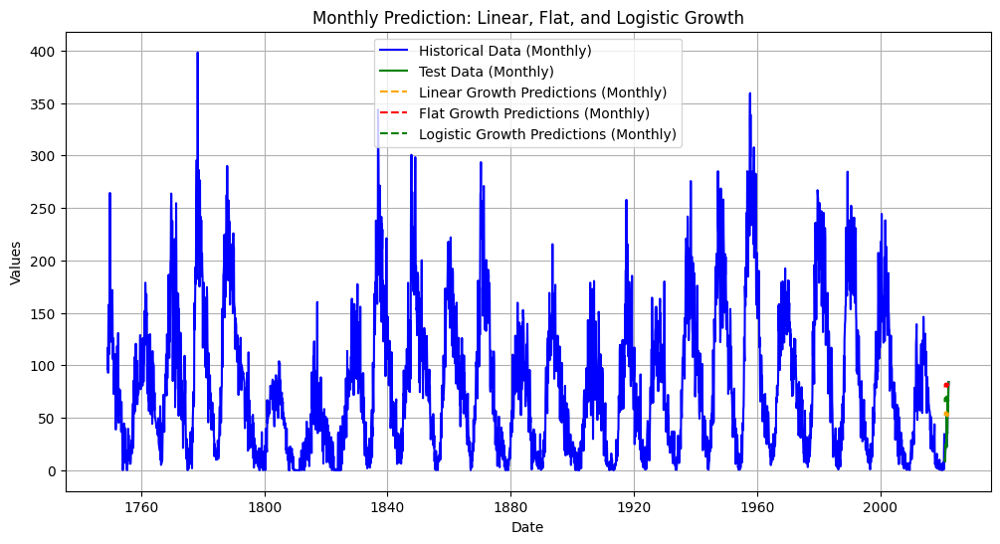

In [ ]:
# --- Plotting the results for Monthly Data ---
plt.figure(figsize=(12, 6))

# Plot historical data
plt.plot(df_monthly['ds'], df_monthly['y'], label='Historical Data (Monthly)', color='blue')

# Plot test data in a different color (e.g., purple)
plt.plot(test_monthly['ds'], test_monthly['y'], label='Test Data (Monthly)', color='green')

# Plot predictions from different models
plt.plot(linear_monthly_forecast['ds'], linear_monthly_forecast['yhat'], label='Linear Growth Predictions (Monthly)', color='orange', linestyle='--')
plt.plot(flat_monthly_forecast['ds'], flat_monthly_forecast['yhat'], label='Flat Growth Predictions (Monthly)', color='red', linestyle='--')
plt.plot(logistic_monthly_forecast['ds'], logistic_monthly_forecast['yhat'], label='Logistic Growth Predictions (Monthly)', color='green', linestyle='--')

# Add titles and labels
plt.title("Monthly Prediction: Linear, Flat, and Logistic Growth")
plt.xlabel("Date")
plt.ylabel("Values")
plt.legend(loc='best')

# Show grid and plot
plt.grid(True)
plt.show()


In [ ]:

# --- Print predicted values for Monthly Data Models ---
print("\nMonthly Linear Growth Model Predicted Values:")
print(linear_monthly_forecast[['ds', 'yhat']].head())

print("\nMonthly Flat Growth Model Predicted Values:")
print(flat_monthly_forecast[['ds', 'yhat']].head())

print("\nMonthly Logistic Growth Model Predicted Values:")
print(logistic_monthly_forecast[['ds', 'yhat']].head())



Monthly Linear Growth Model Predicted Values:
          ds       yhat
0 2021-01-01  51.722297
1 2021-02-01  54.898163
2 2021-03-01  53.971976
3 2021-04-01  53.622846
4 2021-05-01  54.178252

Monthly Flat Growth Model Predicted Values:
          ds       yhat
0 2021-01-01  78.812844
1 2021-02-01  82.046107
2 2021-03-01  81.014469
3 2021-04-01  80.868426
4 2021-05-01  81.525953

Monthly Logistic Growth Model Predicted Values:
          ds       yhat
0 2021-01-01  64.821509
1 2021-02-01  68.913203
2 2021-03-01  65.505527
3 2021-04-01  67.153045
4 2021-05-01  68.170716


# **Daily Data**

Adding column names based on their dataset descriptions

In [ ]:

# Define column names as per SN_d_tot_V2.0.csv
columns = [
    "Year", "Month", "Day", "Fraction_Year",
    "Daily_Sunspot_Number", "Daily_Standard_Deviation",
    "Number_of_Observations", "Definitive_Indicator"
]

# Load the data using StringIO
df_day = pd.read_csv('SN_d_tot_V2.0.csv', delimiter=';', header=None, names=columns)

# Strip any extra spaces from the data
df_day = df_day.apply(lambda x: x.str.strip() if x.dtype == "object" else x)


In [ ]:
df_day.head()

,Year,Month,Day,Fraction_Year,Daily_Sunspot_Number,Daily_Standard_Deviation,Number_of_Observations,Definitive_Indicator
0,1818,1,1,1818.001,-1,-1.0,0,1
1,1818,1,2,1818.004,-1,-1.0,0,1
2,1818,1,3,1818.007,-1,-1.0,0,1
3,1818,1,4,1818.010,-1,-1.0,0,1
4,1818,1,5,1818.012,-1,-1.0,0,1


In [ ]:
# Combine year, month, and day into a datetime column
df_day['date'] = pd.to_datetime(df_day[['Year', 'Month', 'Day']])
df_day.head()

,Year,Month,Day,Fraction_Year,Daily_Sunspot_Number,Daily_Standard_Deviation,Number_of_Observations,Definitive_Indicator,date
0,1818,1,1,1818.001,-1,-1.0,0,1,1818-01-01
1,1818,1,2,1818.004,-1,-1.0,0,1,1818-01-02
2,1818,1,3,1818.007,-1,-1.0,0,1,1818-01-03
3,1818,1,4,1818.010,-1,-1.0,0,1,1818-01-04
4,1818,1,5,1818.012,-1,-1.0,0,1,1818-01-05


In [ ]:
df_day.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74630 entries, 0 to 74629
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Year                      74630 non-null  int64         
 1   Month                     74630 non-null  int64         
 2   Day                       74630 non-null  int64         
 3   Fraction_Year             74630 non-null  float64       
 4   Daily_Sunspot_Number      74630 non-null  int64         
 5   Daily_Standard_Deviation  74630 non-null  float64       
 6   Number_of_Observations    74630 non-null  int64         
 7   Definitive_Indicator      74630 non-null  int64         
 8   date                      74630 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(6)
memory usage: 5.1 MB


In [ ]:
df_day.shape

(74630, 9)

Checking total count of missing values in daily sunspot number. 4.35% of total values are missing

In [ ]:
count = (df_day['Daily_Sunspot_Number'] == -1).sum()
print(count)

3247


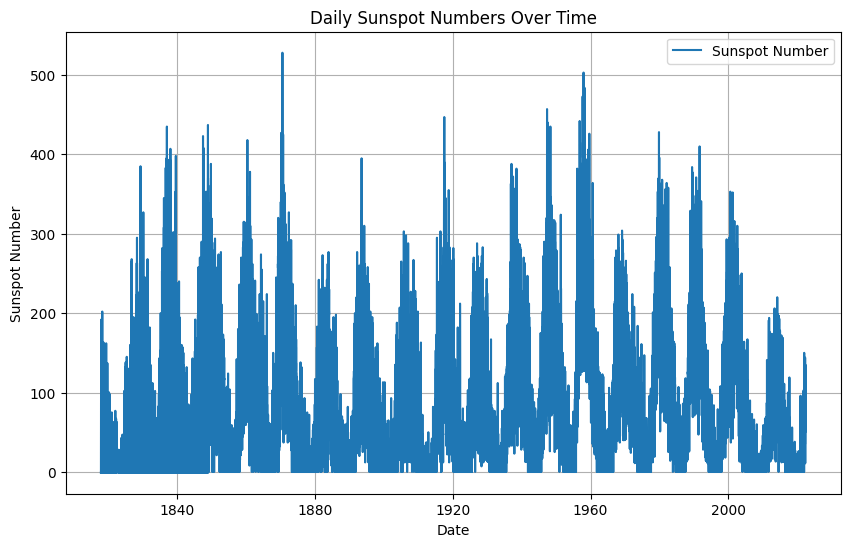

In [ ]:

# Plotting the sunspot data
plt.figure(figsize=(10, 6))

# Plot the sunspot numbers (ignoring -1 for visualization)
plt.plot(df_day['date'], df_day['Daily_Sunspot_Number'], label='Sunspot Number', color='tab:blue')
# Title and labels
plt.title('Daily Sunspot Numbers Over Time')
plt.xlabel('Date')
plt.ylabel('Sunspot Number')

# Show legend and grid
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

In [ ]:
print(df_day['Daily_Sunspot_Number'].describe())


count    74630.000000
mean        78.580142
std         77.303259
min         -1.000000
25%         15.000000
50%         57.000000
75%        123.000000
max        528.000000
Name: Daily_Sunspot_Number, dtype: float64


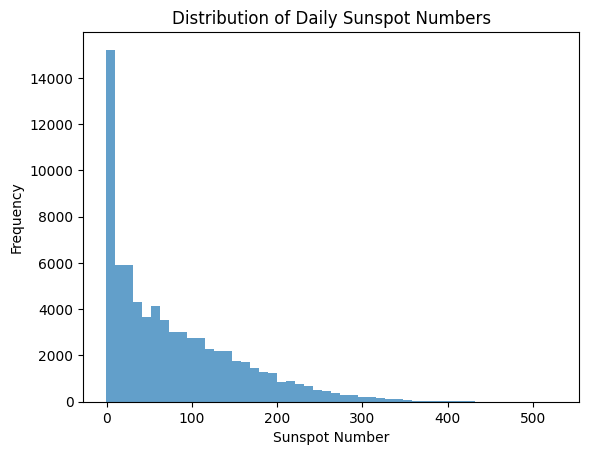

In [ ]:
plt.hist(df_day['Daily_Sunspot_Number'], bins=50, color='tab:blue', alpha=0.7)
plt.title('Distribution of Daily Sunspot Numbers')
plt.xlabel('Sunspot Number')
plt.ylabel('Frequency')
plt.show()


In [ ]:
df_daily = df_day.rename(columns={"date": "ds", "Daily_Sunspot_Number": "y"})
df_daily.head()

,Year,Month,Day,Fraction_Year,y,Daily_Standard_Deviation,Number_of_Observations,Definitive_Indicator,ds
0,1818,1,1,1818.001,-1,-1.0,0,1,1818-01-01
1,1818,1,2,1818.004,-1,-1.0,0,1,1818-01-02
2,1818,1,3,1818.007,-1,-1.0,0,1,1818-01-03
3,1818,1,4,1818.010,-1,-1.0,0,1,1818-01-04
4,1818,1,5,1818.012,-1,-1.0,0,1,1818-01-05


In [ ]:
model_daily = Prophet()
model_daily.fit(df_daily)

future_daily = model_daily.make_future_dataframe(periods=365)
forecast_daily = model_daily.predict(future_daily)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/zp12k0ya.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp57weo3qh/cod_6yft.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64318', 'data', 'file=/tmp/tmp57weo3qh/zp12k0ya.json', 'init=/tmp/tmp57weo3qh/cod_6yft.json', 'output', 'file=/tmp/tmp57weo3qh/prophet_modellm0t2pz2/prophet_model-20241129184143.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:41:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:43:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
# Extract specific periods for predictions
daily_predictions = forecast_daily[forecast_daily['ds'].isin([
    future_daily['ds'].iloc[-100],  # 100 days
    future_daily['ds'].iloc[-200],  # 200 days
    future_daily['ds'].iloc[-1]     # 365 days
])]
print(daily_predictions[['ds', 'yhat']])


              ds       yhat
74795 2022-10-13  24.996843
74895 2023-01-21  18.693605
74994 2023-04-30  24.775301


In [ ]:

pio.renderers.default = "colab"
# Daily Predictions Plot
fig_daily = plot_plotly(model_daily, forecast_daily)
py.iplot(fig_daily)

In [ ]:
forecast_daily[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,1818-01-01,3.518571,-86.239471,91.598969
1,1818-01-02,2.877805,-91.883187,104.428156
2,1818-01-03,3.238277,-86.942236,93.499730
3,1818-01-04,2.871061,-91.169470,96.757030
4,1818-01-05,2.975880,-92.847482,89.278655


In [ ]:
# Plot the results
fig_daily = go.Figure()

# Plot historical data (actual sunspot values)
fig_daily.add_trace(go.Scatter(x=df_daily['ds'], y=df_daily['y'], mode='lines', name='Historical Data', line=dict(color='blue')))

# Plot forecasted data (predictions)
fig_daily.add_trace(go.Scatter(x=forecast_daily['ds'], y=forecast_daily['yhat'], mode='lines', name='Predictions', line=dict(color='red', dash='dash')))

# Highlight specific predictions for 100, 200, and 365 days
fig_daily.add_trace(go.Scatter(x=daily_predictions['ds'], y=daily_predictions['yhat'], mode='markers', name='Selected Predictions',
                              marker=dict(color='green', size=10, symbol='star')))

# Add shading for the future predictions
fig_daily.add_trace(go.Scatter(x=forecast_daily['ds'], y=forecast_daily['yhat_lower'], mode='lines', name='Lower Bound', line=dict(color='grey', dash='dot')))
fig_daily.add_trace(go.Scatter(x=forecast_daily['ds'], y=forecast_daily['yhat_upper'], mode='lines', name='Upper Bound', line=dict(color='grey', dash='dot')))

# Update layout
fig_daily.update_layout(
    title="Daily Sunspot Prediction",
    xaxis_title="Day",
    yaxis_title="Sunspot Number",
    showlegend=True
)

# Show the plot
fig_daily.show()


In [ ]:
from prophet import Prophet
import pandas as pd

# Prepare your data (Make sure your df_daily has 'ds' and 'y' columns)
df_daily['cap'] = 100  # Assuming logistic growth with a cap

# Initialize Prophet model with all the desired settings
model = Prophet(
    growth='logistic',  # 'linear', 'logistic', 'flat'
    yearly_seasonality=False,  # Disable default yearly seasonality to add custom seasonality
    n_changepoints=20,  # Experiment with number of changepoints
    changepoint_prior_scale=0.1  # Experiment with changepoint flexibility
)

# Add custom seasonality (weekly, with 3 Fourier terms)
model.add_seasonality(name='weekly', period=7, fourier_order=3)

# Fit the model
model.fit(df_daily)

# Create future dataframe for prediction
future = model.make_future_dataframe(periods=365)  # Adjust periods as needed




In [ ]:
df_daily ['y'] = 10 - df_daily['y']
df_daily['cap'] = 6
df_daily['floor'] = 1.5
future['cap'] = 6
future['floor'] = 1.5
model = Prophet(growth='logistic')
model.fit(df_daily)
fcst = model.predict(future)
fig = model.plot(fcst)

In [ ]:
from prophet.plot import add_changepoints_to_plot
fig = model.plot(fcst)
a = add_changepoints_to_plot(fig.gca(), model, fcst)


In [ ]:
# Split data into train (80%) and test (20%)
split_index = int(len(df_daily) * 0.8)
train = df_daily.iloc[:split_index].copy()
test = df_daily.iloc[split_index:].copy()

# Define logistic growth cap for train data if needed
train['cap'] = 100

# Initialize and fit Prophet model
model = Prophet(growth='logistic', yearly_seasonality=False, n_changepoints=50, changepoint_prior_scale=0.1)
model.add_seasonality(name='weekly', period=7, fourier_order=5)
model.fit(train)

# Create a dataframe for test predictions
future = model.make_future_dataframe(periods=len(test), freq='D')  # Adjust frequency as needed
future['cap'] = 100  # Add cap if using logistic growth
future['floor'] = 1.5
# Forecast
forecast = model.predict(future)

# Extract predicted values for the test set
test_predictions = forecast.iloc[-len(test):]

# Evaluate metrics
from sklearn.metrics import mean_absolute_error, r2_score
import numpy as np

# Ensure test['y'] is aligned with test_predictions['yhat']
mae = mean_absolute_error(test['y'], test_predictions['yhat'])
mape = np.mean(np.abs((test['y'] - test_predictions['yhat']) / test['y'])) * 100
r2 = r2_score(test['y'], test_predictions['yhat'])

# Print metrics
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")
print(f"R² Score: {r2:.2f}")


In [ ]:
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Train-test split
train = df_daily[df_daily['ds'] < '2021-01-01']  # Up to 2020
test = df_daily[df_daily['ds'] >= '2021-01-01']  # From 2021 onwards

# Linear growth model
linear_model = Prophet(growth='linear',
                       yearly_seasonality=True,
                       weekly_seasonality=False,
                       n_changepoints=50,  # Experiment with number of changepoints
                       changepoint_prior_scale=0.5 )
linear_model.fit(train)

# Flat growth model
flat_model = Prophet(growth='flat',
                     yearly_seasonality=True,
                     weekly_seasonality=False,
                     n_changepoints=50,  # Experiment with number of changepoints
                     changepoint_prior_scale=0.5 )
flat_model.fit(train)

# Create future DataFrame for test data
future_test = test[['ds']]

# Make predictions
linear_forecast = linear_model.predict(future_test)
flat_forecast = flat_model.predict(future_test)

# Evaluation metrics function
def evaluate_model(test, forecast):
    y_true = test['y'].values
    y_pred = forecast['yhat'].values

    mae = mean_absolute_error(y_true, y_pred)
    mape = (abs((y_true - y_pred) / y_true).mean()) * 100  # Mean Absolute Percentage Error
    r2 = r2_score(y_true, y_pred)

    return mae, mape, r2

# Evaluate Linear Model
mae_linear, mape_linear, r2_linear = evaluate_model(test, linear_forecast)
print("Linear Growth Model:")
print(f"MAE: {mae_linear:.2f}, MAPE: {mape_linear:.2f}%, R2: {r2_linear:.2f}")

# Evaluate Flat Model
mae_flat, mape_flat, r2_flat = evaluate_model(test, flat_forecast)
print("\nFlat Growth Model:")
print(f"MAE: {mae_flat:.2f}, MAPE: {mape_flat:.2f}%, R2: {r2_flat:.2f}")

# Plot historical data
plt.figure(figsize=(12, 6))
plt.plot(train['ds'], train['y'], label='Historical Data (Train)', color='blue')
plt.plot(test['ds'], test['y'], label='Historical Data (Test)', color='green')

# Plot Linear Growth Predictions
plt.plot(linear_forecast['ds'], linear_forecast['yhat'], label='Linear Growth Predictions', color='orange', linestyle='--')

# Plot Flat Growth Predictions
plt.plot(flat_forecast['ds'], flat_forecast['yhat'], label='Flat Growth Predictions', color='red', linestyle='--')

# Add plot labels and legend
plt.title("Sunspot Prediction: Linear vs Flat Growth")
plt.xlabel("Date")
plt.ylabel("Sunspot Numbers")
plt.legend(loc='best')
plt.grid(True)

# Show the plot
plt.show()

# Print predicted values for both models
print("\nLinear Growth Model Predicted Values:")
print(linear_forecast[['ds', 'yhat']].head())

print("\nFlat Growth Model Predicted Values:")
print(flat_forecast[['ds', 'yhat']].head())
